# Song Lyric Classification
Team: Steph Clampitt, Anna Graves, Kierra Willis

Dataset for reference: https://www.kaggle.com/datasets/brianblakely/top-100-songs-and-lyrics-from-1959-to-2019

## Preprocessing Steps

In [ ]:
#Load needed packages
import spacy
import pandas as pd
import re
import nltk
import numpy as np
import kagglehub

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.cluster import KMeans # Corrected spelling

nlp = spacy.load('en_core_web_sm')
nltk.download('stopwords')
stop_words = nltk.corpus.stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
#Load dataset - first need to download zipped CSV file from Kaggle link above
from google.colab import files
files.upload() # Choose the zipped csv file

Saving all_songs_data.csv.zip to all_songs_data.csv (1).zip


{'all_songs_data.csv (1).zip': b'PK\x03\x04-\x00\x00\x08\x08\x00e\x97\x9cX\xfaA(]\xff\xff\xff\xff\xff\xff\xff\xff\x12\x00\x14\x00all_songs_data.csv\x01\x00\x10\x000\xa3\xc1\x01\x00\x00\x00\x00!\x84\x86\x00\x00\x00\x00\x00\xec\xbd[\x8f\x1cW\x92&\xf8>\xc0\xfc\x07\x17\x17\xd8\xa4\x84\x88T\xe4=\x93\xc4\x80\xe0E\x12\xb3D\x8a,%KlU\x83(\x1cw?\x11\xe1J\x0f\xf7\x90_2\x18\x1a\x0c\xd0?b^\x16\xd8\x05\xa6_\xf6e1\x7f`\x1f\xb7\xfeI\xff\x92\xb5\xef3;\xee\x1e\xc9H2\x8b\xba\xb4\xaa\xa6\xbbK\xcc\xcc\x88s\xb5c\xc7\xeef\xe7a\x1e\xb7\x8b\x11\xff\x8d\xfe\xf4\xed\xb3\xd1\xc3\xaa\xc9\xeaf\xf4\xa5wM[\xf94\xd2\xbf\xeb\xd1\xb3u\x95%\xf5\xe8\xb9O37\xfa\xd6\x15\x97\xa3o}\xee]\xed\xa3\'\xae\xf1\xa3\x8b\xb2\x98E\xaf\xb2&\xb7_1\xd4\xeb*k|U\x8f\xbe\xf7\xae\xfa\xcf\xff\xe9\x91k\xe4\xdb\xa8\x9cF\xdf\xf8U\xf4\xa2\x92\xceE=\x9a7\xcd\xb2\xbe\xf7\xf9\xe73_dm\xbd\x9b\x94\x8b\xcf\x1d\xd6R\x7f\xfe\x87r^\x14\xeb\xf1\xbc\xac\x9a\xb2\xf8\\{\x8f\xcb\xe9\xb8\xf0\xabqi\xbd\xb5M\xf4\x94mF\xff\xfcft\xe7\x9f\xbf\x93\x19}\xb4\xf7&:/\xa2\

In [ ]:
#Unzip the file
!unzip /content/all_songs_data.csv.zip

# Load the CSV file into a pandas DataFrame
df = pd.read_csv('/content/all_songs_data.csv')

# Convert the 'Year' column to numeric, coercing errors to NaN
df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

# Drop rows where 'Year' could not be converted to a number (NaN)
df.dropna(subset=['Year'], inplace=True)

#Keep top 10 songs from last 25 years
df = df[(df['Year'] >= 2000) & (df['Rank'] <= 10)]

#Replace n-word with n-word
df['Lyrics'] = df['Lyrics'].str.replace('nigga', 'nword')

# Display the first 5 rows of the filtered DataFrame to verify
display(df.head())

Archive:  /content/all_songs_data.csv.zip
replace all_songs_data.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: all_songs_data.csv      


,Album,Album URL,Artist,Featured Artists,Lyrics,Media,Rank,Release Date,Song Title,Song URL,Writers,Year
4100,Breathe,https://genius.com/albums/Faith-hill/Breathe,Faith Hill,[],[Intro] I can feel the magic floating in the a...,[{'native_uri': 'spotify:track:3y4LxiYMgDl4Ret...,1,1999-10-04,Breathe,https://genius.com/Faith-hill-breathe-lyrics,"[{'api_path': '/artists/551029', 'header_image...",2000.0
4101,Supernatural,https://genius.com/albums/Santana/Supernatural,Santana feat. Rob Thomas,"[{'api_path': '/artists/37260', 'header_image_...","[Verse 1] Man, it's a hot one Like seven inche...",[{'native_uri': 'spotify:track:3i3GeK0qLQybu4a...,2,1999-06-15,Smooth,https://genius.com/Santana-smooth-lyrics,"[{'api_path': '/artists/616186', 'header_image...",2000.0
4102,NaN,NaN,Santana feat. The Product GandB,NaN,NaN,NaN,3,NaN,Maria Maria,NaN,NaN,2000.0
4103,My Name Is Joe,https://genius.com/albums/Joe/My-name-is-joe,Joe,[],"[Intro] Yeah, oh yeah Alright, oh, oh, oh [Ve...",[{'native_uri': 'spotify:track:6ctr1K7KzKErxbf...,4,2000-02-07,I Wanna Know,https://genius.com/Joe-i-wanna-know-lyrics,"[{'api_path': '/artists/422438', 'header_image...",2000.0
4104,Everything You Want,https://genius.com/albums/Vertical-horizon/Eve...,Vertical Horizon,[],[Verse 1] Somewhere there's speaking It's alre...,[{'native_uri': 'spotify:track:4cKGldbhGJniI8B...,5,1999-11-30,Everything You Want,https://genius.com/Vertical-horizon-everything...,"[{'api_path': '/artists/619480', 'header_image...",2000.0


In [ ]:
def cleaning(doc):
  #Lemmatizes and removes stopwords
  txt = [token.lemma_ for token in doc if not token.is_stop]
  #only keep sentences with at least 3 words
  if len(txt) > 2:
    return ' '.join(txt)

In [ ]:
brief_cleaning = (re.sub("[^A-Za-z']+", ' ', str(row)).lower() for row in df['Lyrics'])

In [ ]:
#Use spacy pipeline to clean the Lyrics columns
txt = [cleaning(doc) for doc in nlp.pipe(brief_cleaning, batch_size=5000, n_process=-1)]

In [ ]:
#Create finished dataset with artist, song title, rank, year, and clean lyrics
df_clean = pd.DataFrame({'artist': df['Artist'], 'song': df['Song Title'], 'rank': df['Rank'], 'year': df['Year'], 'lyrics': txt})

#There are 2 top 10 songs that don't have lyrics - (1) Maria Maria by Santana and (2) Can't Hold Us by Macklemore - These will be dropped
df_clean = df_clean.dropna().copy()

print(df_clean.head())

                        artist                 song  rank    year  \
4100                Faith Hill              Breathe     1  2000.0   
4101  Santana feat. Rob Thomas               Smooth     2  2000.0   
4103                       Joe         I Wanna Know     4  2000.0   
4104          Vertical Horizon  Everything You Want     5  2000.0   
4105           Destiny's Child          Say My Name     6  2000.0   

                                                 lyrics  
4100    intro feel magic float air get way watch sun...  
4101    verse man hot like seven inch midday sun hea...  
4103    intro yeah oh yeah alright oh oh oh verse am...  
4104    verse speak come oh rise mind feed know skin...  
4105    intro darkchild ' chorus baby love be runnin...  


## Feature Extraction

In [ ]:
corpus = df_clean['lyrics']
stop_words = stop_words
cv = CountVectorizer(ngram_range=(1, 2), min_df=10, max_df=0.8, stop_words=stop_words)
cv_matrix = cv.fit_transform(corpus)
cv_matrix.shape

(238, 467)

## Main Functionality
### Topics

In [ ]:
!pip install pyLDAvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 21.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 74.0 MB/s eta 0:00:00


In [ ]:
import warnings
warnings.filterwarnings('ignore')

warnings.filterwarnings(
    "ignore",
    category=DeprecationWarning,
    message=r".*datetime\.datetime\.utcnow\(\) is deprecated.*"
)

In [ ]:
# Nesseccary imports
from sklearn.decomposition import LatentDirichletAllocation
from pathlib import Path
import joblib

import pyLDAvis
from pyLDAvis.lda_model import prepare
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=DeprecationWarning, module='jupyter_client')

In [ ]:
# Double check the Data structure
df_clean.head()

,artist,song,rank,year,lyrics,kmeans_cluster
4100,Faith Hill,Breathe,1,2000.0,intro feel magic float air get way watch sun...,1
4101,Santana feat. Rob Thomas,Smooth,2,2000.0,verse man hot like seven inch midday sun hea...,2
4103,Joe,I Wanna Know,4,2000.0,intro yeah oh yeah alright oh oh oh verse am...,3
4104,Vertical Horizon,Everything You Want,5,2000.0,verse speak come oh rise mind feed know skin...,3
4105,Destiny's Child,Say My Name,6,2000.0,intro darkchild ' chorus baby love be runnin...,1


In [ ]:
# Text to numbers and make document-term matrix
vectorizer = CountVectorizer(max_df=.5,
                             min_df=5,
                             stop_words='english',
                             max_features=2000)
dtm = vectorizer.fit_transform(df_clean['lyrics'])

In [ ]:
# Create LDA model
lda_all = LatentDirichletAllocation(n_components=5,
                                    max_iter=500,
                                    learning_method='batch',
                                    evaluate_every=10,
                                    random_state=42,
                                    verbose=1)
# Train it
lda_all.fit(dtm)

iteration: 1 of max_iter: 500
iteration: 2 of max_iter: 500
iteration: 3 of max_iter: 500
iteration: 4 of max_iter: 500
iteration: 5 of max_iter: 500
iteration: 6 of max_iter: 500
iteration: 7 of max_iter: 500
iteration: 8 of max_iter: 500
iteration: 9 of max_iter: 500
iteration: 10 of max_iter: 500, perplexity: 397.1923
iteration: 11 of max_iter: 500
iteration: 12 of max_iter: 500
iteration: 13 of max_iter: 500
iteration: 14 of max_iter: 500
iteration: 15 of max_iter: 500
iteration: 16 of max_iter: 500
iteration: 17 of max_iter: 500
iteration: 18 of max_iter: 500
iteration: 19 of max_iter: 500
iteration: 20 of max_iter: 500, perplexity: 391.7787
iteration: 21 of max_iter: 500
iteration: 22 of max_iter: 500
iteration: 23 of max_iter: 500
iteration: 24 of max_iter: 500
iteration: 25 of max_iter: 500
iteration: 26 of max_iter: 500
iteration: 27 of max_iter: 500
iteration: 28 of max_iter: 500
iteration: 29 of max_iter: 500
iteration: 30 of max_iter: 500, perplexity: 390.8987
iteration: 31

LatentDirichletAllocation(evaluate_every=10, max_iter=500, n_components=5,
                          random_state=42, verbose=1)

In [ ]:
# Save the model
topic_model_path = Path('results', 'topic')
if not topic_model_path.exists():
    topic_model_path.mkdir(exist_ok=True, parents=True)

In [ ]:
joblib.dump(lda_all, topic_model_path /'lda_all.pkl')

['results/topic/lda_all.pkl']

In [ ]:
lda_all = joblib.load(topic_model_path / 'lda_all.pkl')

In [ ]:
# Show the topics and relevant words
pyLDAvis.display(prepare(lda_all, dtm, vectorizer))

### Sentiment Analysis

In [ ]:
import nltk
#using vader: a sentiment analysis tool used specifically for social media and lyrics (and it works on unlabeled Data)
from nltk.sentiment import vader
try:
    _ = nltk.data.find('sentiment/vader_lexicon.zip')
except LookupError:
    nltk.download('vader_lexicon')

#analyer tool that tokenizes and returns scores
analyzertool = vader.SentimentIntensityAnalyzer()

#applying the analyzer to each lyric
sent_cols = df_clean['lyrics'].apply(analyzertool.polarity_scores).apply(pd.Series)
df_clean = pd.concat([df_clean, sent_cols], axis=1)

#label using common VADER thresholds
def label_from_compound(x, pos_thr=0.4, neg_thr=-0.4):
    if x >= pos_thr: return 'pos'
    if x <= neg_thr: return 'neg'
    return 'neu'

df_clean['sentiment_label'] = df_clean['compound'].apply(label_from_compound)

display(df_clean.head())


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


,artist,song,rank,year,lyrics,kmeans_cluster,neg,neu,pos,compound,sentiment_label
4100,Faith Hill,Breathe,1,2000.0,intro feel magic float air get way watch sun...,1,0.044,0.852,0.103,0.8807,pos
4101,Santana feat. Rob Thomas,Smooth,2,2000.0,verse man hot like seven inch midday sun hea...,2,0.158,0.591,0.251,0.9712,pos
4103,Joe,I Wanna Know,4,2000.0,intro yeah oh yeah alright oh oh oh verse am...,3,0.075,0.506,0.419,0.9977,pos
4104,Vertical Horizon,Everything You Want,5,2000.0,verse speak come oh rise mind feed know skin...,3,0.045,0.784,0.171,0.8779,pos
4105,Destiny's Child,Say My Name,6,2000.0,intro darkchild ' chorus baby love be runnin...,1,0.015,0.596,0.388,0.9993,pos


,year,compound
0,2000.0,0.932233
1,2001.0,0.523120
2,2002.0,0.073800
3,2003.0,0.551490
4,2004.0,0.735350


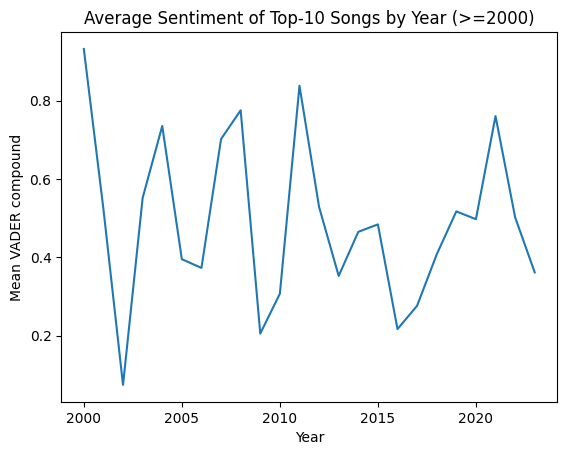

,year,artist,song,compound
4209,2001.0,Destiny's Child,Independent Women Part I,0.9998
4307,2002.0,Fat Joe feat. Ashanti,What's Luv?,0.9998
5405,2013.0,Justin Timberlake,Mirrors,0.9997
4504,2004.0,OutKast feat. Sleepy Brown,The Way You Move,0.9996
5500,2014.0,Pharrell Williams,Happy,0.9996


,year,artist,song,compound
5805,2017.0,Migos Featuring Lil Uzi Vert,Bad And Boujee,-0.9994
5803,2017.0,Kendrick Lamar,Humble.,-0.9993
5001,2009.0,Lady Gaga,Poker Face,-0.9992
4601,2005.0,Gwen Stefani,Hollaback Girl,-0.9990
4900,2008.0,Flo Rida feat. T-Pain,Low,-0.9982


In [ ]:
#graphs for sentiment analysis
#yearly average sentiment
yearly = df_clean.groupby('year', as_index=False)['compound'].mean().sort_values('year')
display(yearly.head())

#matplotlib line
import matplotlib.pyplot as plt
plt.figure()
plt.plot(yearly['year'], yearly['compound'])
plt.xlabel('Year'); plt.ylabel('Mean VADER compound'); plt.title('Average Sentiment of Top-10 Songs by Year (>=2000)')
plt.show()

#top & bottom songs by compound
top5 = df_clean.nlargest(5, 'compound')[['year','artist','song','compound']]
bottom5 = df_clean.nsmallest(5, 'compound')[['year','artist','song','compound']]
display(top5, bottom5)


### Similarity

#### Clustering using K-Means

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

#Add additional stopwords - mostly filler words in songs
stop_words_custom = ['yeah', 'ya', 'yea', 'oh', 'ohh', 'ooh', 'woah', 'whoa', 'ayy', 'uh', 'na', 'hey', 'la', 'doo', 'da']
# Combine the stop words lists and convert to a set to ensure uniqueness, then back to a list
combined_stop_words = list(set(stop_words + stop_words_custom))

vectorizer = TfidfVectorizer(stop_words=combined_stop_words)
vectorized_songs = vectorizer.fit_transform(df_clean['lyrics'])


In [ ]:
from sklearn.decomposition import PCA

#Get number of coments that explain 95% of variance
pca = PCA(n_components=0.95)
reduced_data = pca.fit_transform(vectorized_songs.toarray())

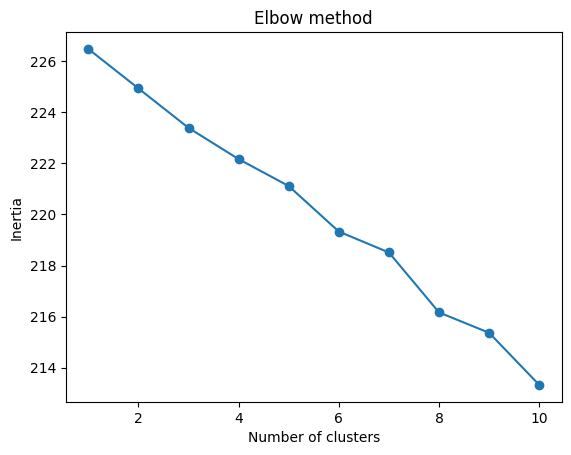

In [ ]:
from sklearn.cluster import KMeans

inertias = []

for i in range(1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(vectorized_songs)
    inertias.append(kmeans.inertia_)

plt.plot(range(1,11), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [ ]:
num_clusters = 5
km = KMeans(n_clusters=num_clusters, max_iter=10000, n_init=50, random_state=42).fit(vectorized_songs)

In [ ]:
df_clean['kmeans_cluster'] = km.labels_

In [ ]:
song_clusters = (df_clean[['song', 'kmeans_cluster', 'rank']]
                 .sort_values(by=['kmeans_cluster', 'rank'])
                 .groupby('kmeans_cluster').head(20))
song_clusters = song_clusters.copy(deep=True)
song_clusters

,song,kmeans_cluster,rank
4400,In Da Club,0,1
5000,Boom Boom Pow,0,1
5100,TiK ToK,0,1
5400,Thrift Shop,0,1
5600,Uptown Funk!,0,1
...,...,...,...
6404,Creepin',4,5
4905,No Air,4,6
6305,First Class,4,6
4306,In the End,4,7


In [ ]:
# Get feature names from the TfidfVectorizer used for clustering
feature_names = vectorizer.get_feature_names_out()
topn_features = 15
ordered_centroids = km.cluster_centers_.argsort()[:, ::-1]

# get key features for each cluster
# get movies belonging to each cluster
for cluster_num in range(num_clusters):
    key_features = [feature_names[index]
                        for index in ordered_centroids[cluster_num, :topn_features]]
    songs = song_clusters[song_clusters['kmeans_cluster'] == cluster_num]['song'].values.tolist()
    print('CLUSTER #'+str(cluster_num+1))
    print('Key Features:', key_features)
    print('Popular Songs:', songs)
    print('-'*80)

CLUSTER #1
Key Features: ['get', 'like', 'girl', 'nword', 'boom', 'shit', 'go', 'look', 'right', 'old', 'say', 'bitch', 'chorus', 'dance', 'know']
Popular Songs: ['In Da Club', 'Boom Boom Pow', 'TiK ToK', 'Thrift Shop', 'Uptown Funk!', 'Old Town Road', 'Ignition', 'Hollaback Girl', 'Poker Face', 'All For You', 'Hot in Herre', 'Just Dance', 'The Box', 'Crazy In Love', 'E.T.', 'Fancy', 'Humble.', 'Mood', '1, 2 Step', 'Wow.']
--------------------------------------------------------------------------------
CLUSTER #2
Key Features: ['love', 'baby', 'way', 'cause', 'chorus', 'know', 'go', 'like', 'get', 'come', 'well', 'write', 'want', 'need', 'life']
Popular Songs: ['Breathe', 'Hanging By A Moment', 'We Belong Together', 'Love Yourself', 'Shape Of You', 'Last Night', "Fallin'", 'Bleeding Love', 'Dark Horse', 'Thinking Out Loud', 'Perfect', 'Flowers', 'Let Me Love You', 'All Of Me', 'California Gurls', "I'm Real", "When I'm Gone", 'The Way You Move', 'Love Story', 'OMG']
--------------------

In [ ]:
import matplotlib.pyplot as plt

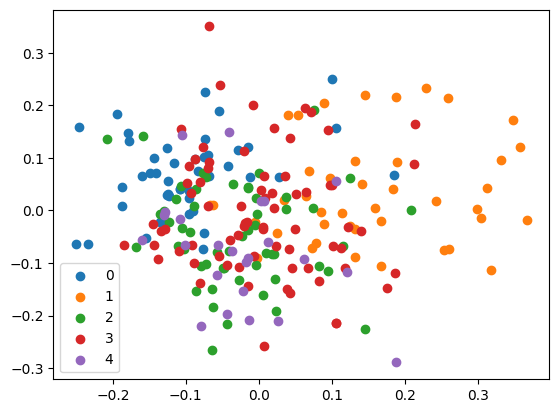

In [ ]:
for i in range(num_clusters):
    plt.scatter(reduced_data[km.labels_ == i, 0]
                , reduced_data[km.labels_ == i, 1], label = i)
plt.legend()
plt.show()

#### Dendrogram

In [ ]:
model_matrix = vectorized_songs.toarray()

from sklearn.metrics.pairwise import cosine_similarity
similarity_matrix = cosine_similarity(model_matrix)

In [ ]:
similarity_matrix

array([[1.        , 0.06905755, 0.09617458, ..., 0.10772145, 0.02931592,
        0.05491967],
       [0.06905755, 1.        , 0.09663673, ..., 0.04083988, 0.02356718,
        0.07044637],
       [0.09617458, 0.09663673, 1.        , ..., 0.06019987, 0.06763149,
        0.17885077],
       ...,
       [0.10772145, 0.04083988, 0.06019987, ..., 1.        , 0.06454234,
        0.02555168],
       [0.02931592, 0.02356718, 0.06763149, ..., 0.06454234, 1.        ,
        0.01952079],
       [0.05491967, 0.07044637, 0.17885077, ..., 0.02555168, 0.01952079,
        1.        ]])

In [ ]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Generate the linkage matrix
# Using 'ward' method for linkage, but other methods can be used
Z = linkage(model_matrix, 'ward')

def plot_hierarchical_clusters(linkage_matrix, data, p=100, figure_size=(8,12)):
    # set size
    fig, ax = plt.subplots(figsize=figure_size)
    movie_titles = data['song'].values.tolist()
    # plot dendrogram
    R = dendrogram(linkage_matrix, orientation="left", labels=movie_titles,
                    truncate_mode='lastp',
                    p=p,
                    no_plot=True)
    temp = {R["leaves"][ii]: movie_titles[ii] for ii in range(len(R["leaves"]))}
    def llf(xx):
        return "{}".format(temp[xx])
    ax = dendrogram(
            linkage_matrix,
            truncate_mode='lastp',
            orientation="left",
            p=p,
            leaf_label_func=llf,
            leaf_font_size=10.,
            )
    plt.tick_params(axis= 'x',
                    which='both',
                    bottom='off',
                    top='off',
                    labelbottom='off')
    plt.tight_layout()
    plt.savefig('song_hierachical_clusters.png', dpi=200)

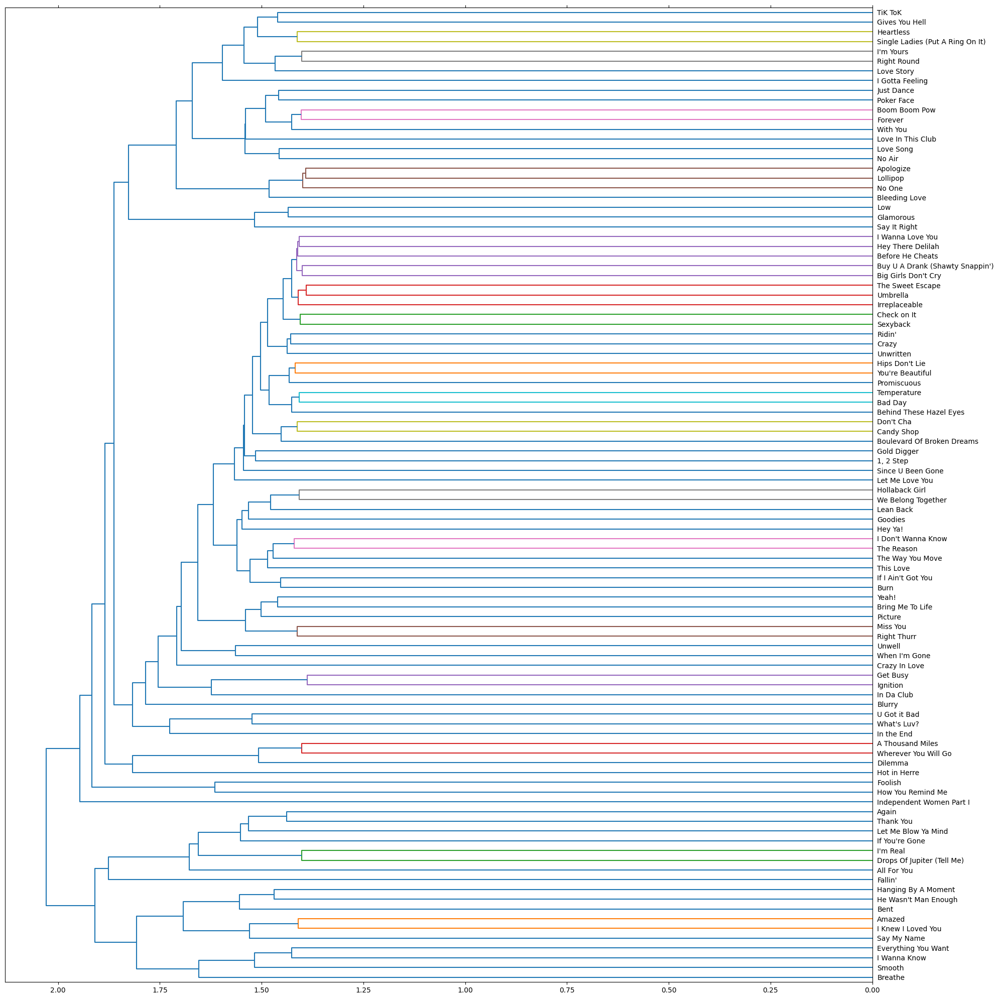

In [ ]:
plot_hierarchical_clusters(Z, p=100, data=df_clean, figure_size=(20,20))

## Personal Contribution Statement